<a href="https://colab.research.google.com/github/saketlakhotia17/Lane-Detection/blob/main/Lane_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# *Lane Detection*

Dataset: [CULane](https://arxiv.org/pdf/1712.06080.pdf) + Custom images



CULane is a large scale challenging dataset for academic research on traffic lane detection. It is collected by cameras mounted on six different vehicles driven by different drivers in Beijing. More than 55 hours of videos were collected and 133,235 frames were extracted. Data examples are shown above.

We have divided the dataset into 88880 for training set, 9675 for validation set, and 34680 for test set.

## Method 

Open CV

##Introduction

OpenCV is a cross-platform library using which we can develop real-time computer vision applications. It mainly focuses on image processing, video capture and analysis including features like face detection and object detection.

Computer vision is a process by which we can understand the images and videos how they are stored and how we can manipulate and retrieve data from them.

It plays a major role in real-time operation, one can process images and videos to identify objects, faces, or even handwriting of a human

Lane detection is a critical component of self-driving cars and autonomous vehicles. It is one of the most important research topics for driving scene understanding. Once lane positions are obtained, the vehicle will know where to go and avoid the risk of running into other lanes or getting off the road. This can prevent the driver/car system from drifting off the driving lane.

In [1]:
!unzip "/content/drive/MyDrive/test_images.zip"

unzip:  cannot find or open /content/drive/MyDrive/test_images.zip, /content/drive/MyDrive/test_images.zip.zip or /content/drive/MyDrive/test_images.zip.ZIP.


In [ ]:
!pip install --upgrade IPython

     |████████████████████████████████| 788kB 16.8MB/s 
     |████████████████████████████████| 368kB 21.6MB/s 
ERROR: jupyter-console 5.2.0 has requirement prompt-toolkit<2.0.0,>=1.0.0, but you'll have prompt-toolkit 3.0.18 which is incompatible.
ERROR: google-colab 1.0.0 has requirement ipython~=5.5.0, but you'll have ipython 7.22.0 which is incompatible.
  Found existing installation: prompt-toolkit 1.0.18
    Uninstalling prompt-toolkit-1.0.18:
      Successfully uninstalled prompt-toolkit-1.0.18
  Found existing installation: ipython 5.5.0
    Uninstalling ipython-5.5.0:
      Successfully uninstalled ipython-5.5.0


Steps:

1. Perspective transform to rectify binary image ("birds-eye view").
2. Use color transforms, gradients, etc., to create a thresholded binary image.
3. Detect lane pixels and fit to find the lane boundary.
6. Determine the curvature of the lane and vehicle position with respect to center.
4. Warp the detected lane boundaries back onto the original image.
5. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## Imports

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from IPython.display import HTML, Video
from moviepy.editor import VideoFileClip

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)3833856/45929032 bytes (8.3%)7929856/45929032 bytes (17.3%)11935744/45929032 bytes (26.0%)15720448/45929032 bytes (34.2%)19857408/45929032 bytes (43.2%)23855104/45929032 bytes (51.9%)27803648/45929032 bytes (60.5%)31662080/45929032 bytes (68.9%)35627008/45929032 bytes (77.6%)39272448/45929032 bytes (85.5%)43401216/45929032 bytes (94.5%)45929032/45929032 bytes (100.0%)
  Done
File saved as /root

## Step 1: Perspective transformation

In Perspective Transformation, we can change the perspective of a given image or video for getting better insights about the required information. In Perspective Transformation, we need provide the points on the image from which want to gather information by changing the perspective. We also need to provide the points inside which we want to display our image. Then, we get the perspective transform from the two given set of points and wrap it with the original image.

In [ ]:
class PerspectiveTransformation:
    """ This a class for transforming image between front view and top view
    Attributes:
        src (np.array): Coordinates of 4 source points
        dst (np.array): Coordinates of 4 destination points
        M (np.array): Matrix to transform image from front view to top view
        M_inv (np.array): Matrix to transform image from top view to front view
    """
    def __init__(self):
        """Init PerspectiveTransformation."""
        self.src = np.float32([(550, 460),     # top-left
                               (150, 720),     # bottom-left
                               (1200, 720),    # bottom-right
                               (770, 460)])    # top-right
        self.dst = np.float32([(100, 0),
                               (100, 720),
                               (1100, 720),
                               (1100, 0)])
        self.M = cv2.getPerspectiveTransform(self.src, self.dst)
        self.M_inv = cv2.getPerspectiveTransform(self.dst, self.src)

    def forward(self, img, img_size=(1280, 720), flags=cv2.INTER_LINEAR):
        """ Take a front view image and transform to top view
        Parameters:
            img (np.array): A front view image
            img_size (tuple): Size of the image (width, height)
            flags : flag to use in cv2.warpPerspective()
        Returns:
            Image (np.array): Top view image
        """
        return cv2.warpPerspective(img, self.M, img_size, flags=flags)

    def backward(self, img, img_size=(1280, 720), flags=cv2.INTER_LINEAR):
        """ Take a top view image and transform it to front view
        Parameters:
            img (np.array): A top view image
            img_size (tuple): Size of the image (width, height)
            flags (int): flag to use in cv2.warpPerspective()
        Returns:
            Image (np.array): Front view image
        """
        return cv2.warpPerspective(img, self.M_inv, img_size, flags=flags)

## 2. Identify the lane lines

In [ ]:
def hist(img):
    bottom_half = img[img.shape[0]//2:,:]
    return np.sum(bottom_half, axis=0)

class LaneLines:
    """ Class containing information about detected lane lines.
    Attributes:
        left_fit (np.array): Coefficients of a polynomial that fit left lane line
        right_fit (np.array): Coefficients of a polynomial that fit right lane line
        parameters (dict): Dictionary containing all parameters needed for the pipeline
        debug (boolean): Flag for debug/normal mode
    """
    def __init__(self):
        """Init Lanelines.
        Parameters:
            left_fit (np.array): Coefficients of polynomial that fit left lane
            right_fit (np.array): Coefficients of polynomial that fit right lane
            binary (np.array): binary image
        """
        self.left_fit = None
        self.right_fit = None
        self.binary = None
        self.nonzero = None
        self.nonzerox = None
        self.nonzeroy = None
        self.clear_visibility = True
        self.dir = []

        # HYPERPARAMETERS
        # Number of sliding windows
        self.nwindows = 9
        # Width of the the windows +/- margin
        self.margin = 100
        # Mininum number of pixels found to recenter window
        self.minpix = 50

    def forward(self, img):
        """Take a image and detect lane lines.
        Parameters:
            img (np.array): An binary image containing relevant pixels
        Returns:
            Image (np.array): An RGB image containing lane lines pixels and other details
        """
        self.extract_features(img)
        return self.fit_poly(img)

    def pixels_in_window(self, center, margin, height):
        """ Return all pixel that in a specific window
        Parameters:
            center (tuple): coordinate of the center of the window
            margin (int): half width of the window
            height (int): height of the window
        Returns:
            pixelx (np.array): x coordinates of pixels that lie inside the window
            pixely (np.array): y coordinates of pixels that lie inside the window
        """
        topleft = (center[0]-margin, center[1]-height//2)
        bottomright = (center[0]+margin, center[1]+height//2)

        condx = (topleft[0] <= self.nonzerox) & (self.nonzerox <= bottomright[0])
        condy = (topleft[1] <= self.nonzeroy) & (self.nonzeroy <= bottomright[1])
        return self.nonzerox[condx&condy], self.nonzeroy[condx&condy]

    def extract_features(self, img):
        """ Extract features from a binary image
        Parameters:
            img (np.array): A binary image
        """
        self.img = img
        # Height of of windows - based on nwindows and image shape
        self.window_height = np.int(img.shape[0]//self.nwindows)

        # Identify the x and y positions of all nonzero pixel in the image
        self.nonzero = img.nonzero()
        self.nonzerox = np.array(self.nonzero[1])
        self.nonzeroy = np.array(self.nonzero[0])

    def find_lane_pixels(self, img):
        """Find lane pixels from a binary warped image.
        Parameters:
            img (np.array): A binary warped image
        Returns:
            leftx (np.array): x coordinates of left lane pixels
            lefty (np.array): y coordinates of left lane pixels
            rightx (np.array): x coordinates of right lane pixels
            righty (np.array): y coordinates of right lane pixels
            out_img (np.array): A RGB image that use to display result later on.
        """
        assert(len(img.shape) == 2)

        # Create an output image to draw on and visualize the result
        out_img = np.dstack((img, img, img))

        histogram = hist(img)
        midpoint = histogram.shape[0]//2
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # Current position to be update later for each window in nwindows
        leftx_current = leftx_base
        rightx_current = rightx_base
        y_current = img.shape[0] + self.window_height//2

        # Create empty lists to reveice left and right lane pixel
        leftx, lefty, rightx, righty = [], [], [], []

        # Step through the windows one by one
        for _ in range(self.nwindows):
            y_current -= self.window_height
            center_left = (leftx_current, y_current)
            center_right = (rightx_current, y_current)

            good_left_x, good_left_y = self.pixels_in_window(center_left, self.margin, self.window_height)
            good_right_x, good_right_y = self.pixels_in_window(center_right, self.margin, self.window_height)

            # Append these indices to the lists
            leftx.extend(good_left_x)
            lefty.extend(good_left_y)
            rightx.extend(good_right_x)
            righty.extend(good_right_y)

            if len(good_left_x) > self.minpix:
                leftx_current = np.int32(np.mean(good_left_x))
            if len(good_right_x) > self.minpix:
                rightx_current = np.int32(np.mean(good_right_x))

        return leftx, lefty, rightx, righty, out_img

    def fit_poly(self, img):
        """Find the lane line from an image and draw it.
        Parameters:
            img (np.array): a binary warped image
        Returns:
            out_img (np.array): a RGB image that have lane line drawn on that.
        """

        leftx, lefty, rightx, righty, out_img = self.find_lane_pixels(img)

        if len(lefty) > 1500:
            self.left_fit = np.polyfit(lefty, leftx, 2)
        if len(righty) > 1500:
            self.right_fit = np.polyfit(righty, rightx, 2)

        # Generate x and y values for plotting
        maxy = img.shape[0] - 1
        miny = img.shape[0] // 3
        if len(lefty):
            maxy = max(maxy, np.max(lefty))
            miny = min(miny, np.min(lefty))

        if len(righty):
            maxy = max(maxy, np.max(righty))
            miny = min(miny, np.min(righty))

        ploty = np.linspace(miny, maxy, img.shape[0])

        left_fitx = self.left_fit[0]*ploty**2 + self.left_fit[1]*ploty + self.left_fit[2]
        right_fitx = self.right_fit[0]*ploty**2 + self.right_fit[1]*ploty + self.right_fit[2]

        # Visualization
        for i, y in enumerate(ploty):
            l = int(left_fitx[i])
            r = int(right_fitx[i])
            y = int(y)
            cv2.line(out_img, (l, y), (r, y), (0, 255, 0))

        lR, rR, pos = self.measure_curvature()

        return out_img

    def plot(self, out_img):
        
        return out_img

    def measure_curvature(self):
        ym = 30/720
        xm = 3.7/700

        left_fit = self.left_fit.copy()
        right_fit = self.right_fit.copy()
        y_eval = 700 * ym

        # Compute R_curve (radius of curvature) R=[1+(y′(x))2]32|y′′(x)|.
        left_curveR =  ((1 + (2*left_fit[0] *y_eval + left_fit[1])**2)**1.5)  / np.absolute(2*left_fit[0])
        right_curveR = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])

        xl = np.dot(self.left_fit, [700**2, 700, 1])
        xr = np.dot(self.right_fit, [700**2, 700, 1])
        pos = (1280//2 - (xl+xr)//2)*xm
        return left_curveR, right_curveR, pos 

## Loading Test Images for visualization

In [ ]:
images = []
images.append(mpimg.imread('test_images/challenge_video_frame_1.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_100.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_110.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_120.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_130.jpg'))
images.append(mpimg.imread('test_images/challenge_video_frame_140.jpg'))

In [ ]:
images[0].shape # 720 * 1280 * 3 channels RGB

(720, 1280, 3)

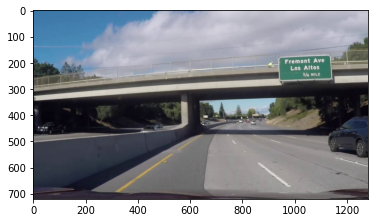

In [ ]:
plt.imshow(images[1])

In [ ]:
images1 = []
images1.append(mpimg.imread('test_images/project_video_frame_1032.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_1048.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_235.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_810.jpg'))
images1.append(mpimg.imread('test_images/project_video_frame_551.jpg'))

In [ ]:
images1[0].shape

(720, 1280, 3)

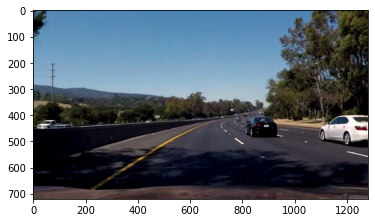

In [ ]:
plt.imshow(images1[1])

In [ ]:
images2 = []
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_1.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_10.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_100.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_200.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_300.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_400.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_500.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_600.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_700.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_800.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_900.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_1000.jpg'))
images2.append(mpimg.imread('test_images/harder_challenge_video_frame_1100.jpg'))

In [ ]:
images2[0].shape

(720, 1280, 3)

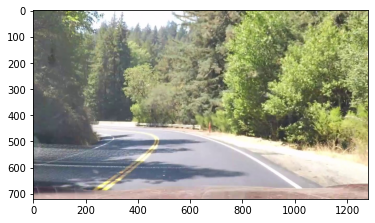

In [ ]:
plt.imshow(images2[5])

## RGB to HLS

In [ ]:
def plot(img):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS) # RGB to Hue (H),Saturation (S), Lightness (L)
    f = plt.figure(figsize=(24, 9))
    f.suptitle("RGB To HLS", size = 32)

    ax1 = f.add_subplot(2, 2, 1)
    ax1.set_xlabel("Hue", fontsize = 16)
    ax1.imshow(hls[:,:,0], cmap='gray', vmin=0, vmax=255)
    ax2 = f.add_subplot(2, 2, 2)
    ax2.set_xlabel("Lightness", fontsize = 16)
    ax2.imshow(hls[:,:,1], cmap='gray', vmin=0, vmax=255)
    ax3 = f.add_subplot(2, 2, 3)
    ax3.set_xlabel("Saturation", fontsize = 16)
    ax3.imshow(hls[:,:,2], cmap='gray', vmin=0, vmax=255)
    ax4 = f.add_subplot(2, 2, 4)
    ax4.set_xlabel("Original Image (in RGB)", fontsize = 16)
    ax4.imshow(img)
    plt.figure()
    plt.show()

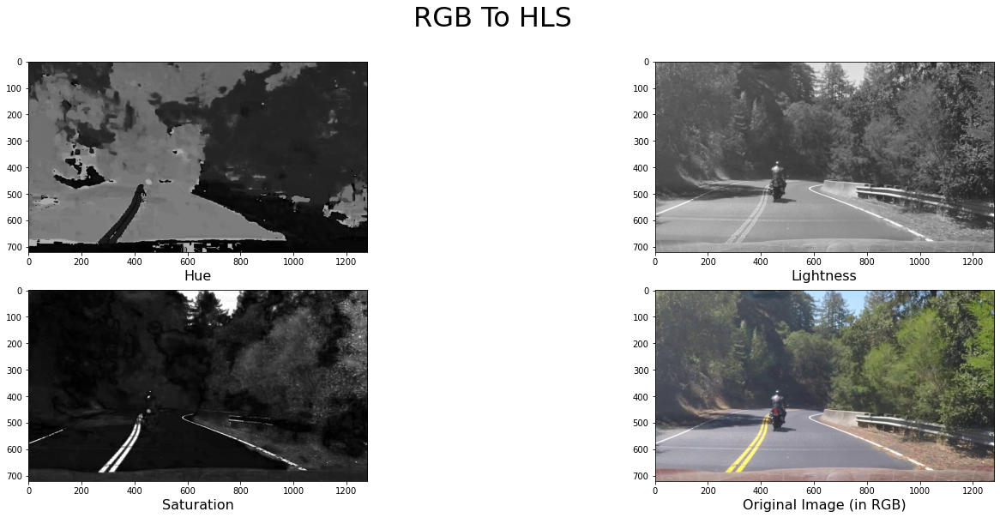

<Figure size 432x288 with 0 Axes>

In [ ]:
img = images2[2]
birdeye = PerspectiveTransformation()
plot(img)

Threshold the image using gradients and colors. 

Thresholding is a method of isolating the pixels we are interested in. This can be done using a combination of gradient and color filters.

We applied pixel-gradient and color threshold filters to narrow down the pixels of interest (lane lines)

In [ ]:
#ColorMap Normalization
def threshold_rel(img, lo, hi):
    vmin = np.min(img)
    vmax = np.max(img)
    
    vlo = vmin + (vmax - vmin) * lo
    vhi = vmin + (vmax - vmin) * hi
    return np.uint8((img >= vlo) & (img <= vhi)) * 255 # Returns Unsigned integer range( 0-255 )

def threshold_abs(img, lo, hi):
    return np.uint8((img >= lo) & (img <= hi)) * 255 # Returns Unsigned integer range( 0-255 )

We dont want automatic scaling of the colormap, so using vmin and vmax to set the range 

When showing a numpy array, matplotlib can only automatically know the range of the actual input data (not the range it was taken from), so it takes the full input range an maps it to the full output range. But if we know a different range of the input data, we can use vmin and vmax to specify it.


## HLSV

In [ ]:
def test(img):
    tmp = birdeye.forward(img)
    tmp = np.copy(img)
    hls = cv2.cvtColor(tmp, cv2.COLOR_RGB2HLS)
    hsv = cv2.cvtColor(tmp, cv2.COLOR_RGB2HSV)
    h_channel = hls[:,:,0] #HUE
    l_channel = hls[:,:,1] #lightness
    s_channel = hls[:,:,2] #Saturation
    v_channel = hsv[:,:,2] # Value
    
    f = plt.figure(figsize=(24, 16))
    f.suptitle("Applying HLSV on Forward Image", size = 32)
    ax1 = f.add_subplot(2, 2, 1)
    ax1.set_xlabel("Original Image", fontsize = 16)
    ax1.imshow(tmp)

    ax2 = f.add_subplot(2, 2, 2)
    ax2.set_xlabel("Lightness", fontsize = 16)
    ax2.imshow(threshold_rel(l_channel, 0.8, 1.0), vmin=0, vmax=255, cmap='gray')
    
    ax3 = f.add_subplot(2, 2, 3)
    ax3.set_xlabel("Saturation", fontsize = 16)
    ax3.imshow(threshold_rel(s_channel, 0.5, 0.8), vmin=0, vmax=255, cmap='gray')
    
    ax4 = f.add_subplot(2, 2, 4)
    res = threshold_abs(h_channel, 20, 30)
    res &= threshold_rel(v_channel, 0.7, 1.0)
    ax4.set_xlabel("Hue and Value Combined", fontsize = 16)
    ax4.imshow(res, vmin=0, vmax=255, cmap='gray')

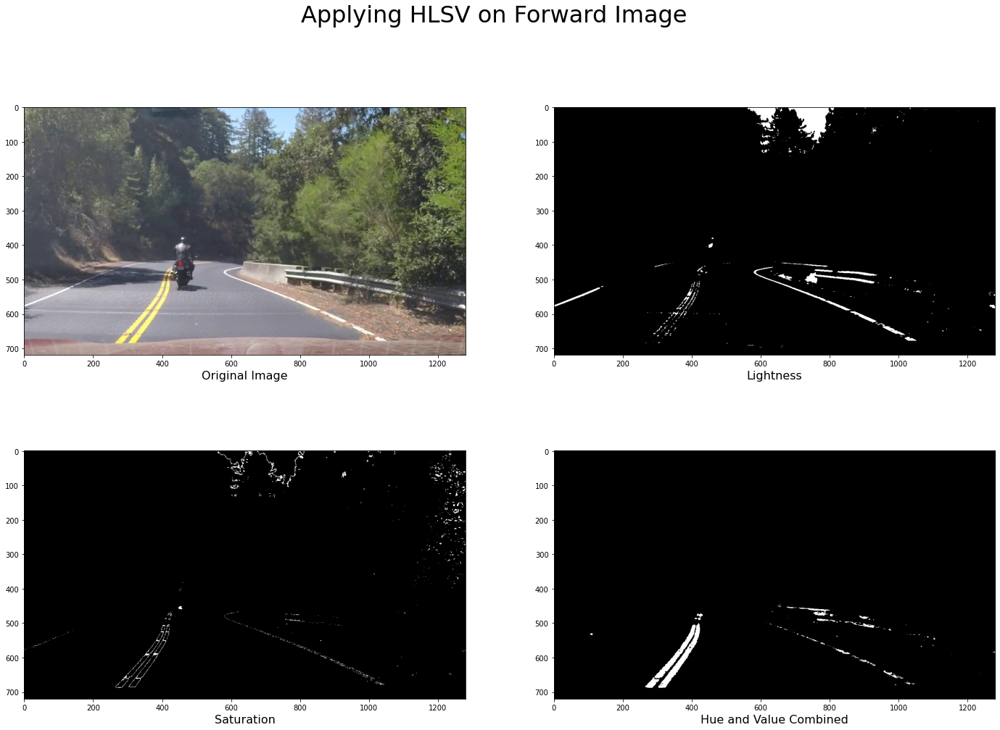

In [ ]:
test(images2[2])

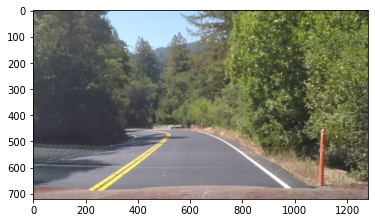

In [ ]:
img = images2[1]
plt.imshow(img)

Top View of the above image

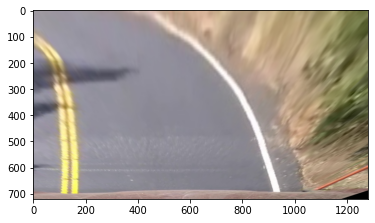

In [ ]:
img1 = birdeye.forward(img)
plt.imshow(img1)

## RGB to HLSV on TopView

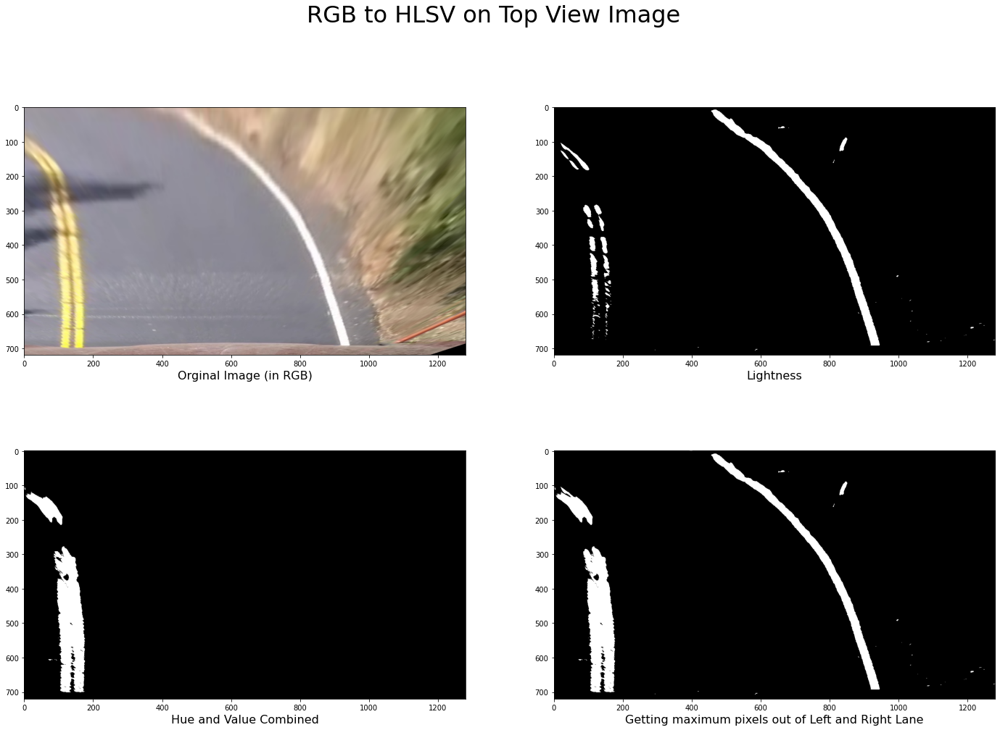

In [ ]:
hls = cv2.cvtColor(img1, cv2.COLOR_RGB2HLS)
hsv = cv2.cvtColor(img1, cv2.COLOR_RGB2HSV)
h_channel = hls[:,:,0]
l_channel = hls[:,:,1]
s_channel = hls[:,:,2]
v_channel = hsv[:,:,2]

f = plt.figure(figsize=(24, 16))
f.suptitle("RGB to HLSV on Top View Image", size = 32)

ax1 = f.add_subplot(2, 2, 1)
ax1.set_xlabel("Orginal Image (in RGB)", fontsize = 16)
ax1.imshow(img1)

ax2 = f.add_subplot(2, 2, 2)
ax2.set_xlabel("Lightness", fontsize = 16)
right_lane = threshold_rel(l_channel, 0.8, 1.0)
# right_lane[:,:750] = 0
ax2.imshow(right_lane, vmin=0, vmax=255, cmap='gray')

ax3 = f.add_subplot(2, 2, 3)
ax3.set_xlabel("Hue and Value Combined", fontsize = 16)
left_lane = threshold_abs(h_channel, 20, 30)
left_lane &= threshold_rel(v_channel, 0.7, 1.0)
left_lane[:,550:] = 0
ax3.imshow(left_lane, vmin=0, vmax=255, cmap='gray')

img2 = left_lane | right_lane
ax4 = f.add_subplot(2, 2, 4)
ax4.set_xlabel("Getting maximum pixels out of Left and Right Lane", fontsize = 16)
ax4.imshow(img2, vmin=0, vmax=255, cmap='gray')

## Predicting lanes

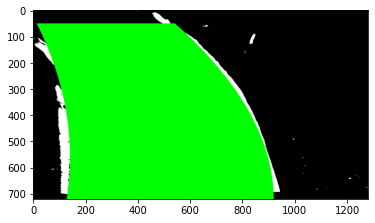

In [ ]:
lanelines = LaneLines() # The class
img3 = lanelines.forward(img2)
plt.imshow(img3)

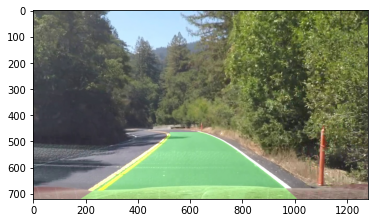

In [ ]:
img4 = birdeye.backward(img3)
out_img = cv2.addWeighted(img, 1, img4, 0.3, 0)
plt.imshow(out_img)

In [ ]:
birdeye = PerspectiveTransformation() # Creating object of the PerspectiveTransformation class
lanelines = LaneLines()  # Creating object of the LaneLines class
def process_image(img):
    # step 1
    img1 = birdeye.forward(img)

    
    # step 2
    hls = cv2.cvtColor(img1, cv2.COLOR_RGB2HLS)
    hsv = cv2.cvtColor(img1, cv2.COLOR_RGB2HSV)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    v_channel = hsv[:,:,2]

    right_lane = threshold_rel(l_channel, 0.8, 1.0)
    right_lane[:,:750] = 0

    left_lane = threshold_abs(h_channel, 20, 30)
    left_lane &= threshold_rel(v_channel, 0.7, 1.0)
    left_lane[:,550:] = 0

    img2 = left_lane | right_lane
     
    # step 3
    img3 = lanelines.forward(img2)
    
    # step 4
    img4 = birdeye.backward(img3)
    out_img = cv2.addWeighted(img, 1, img4, 1, 0)
    
    return out_img

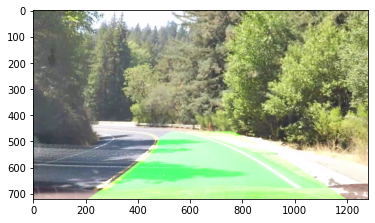

In [ ]:
tmp = process_image(images2[5])
plt.imshow(tmp)

## Output from video

In [ ]:
clip = VideoFileClip("project_video.mp4")

In [ ]:
out_clip = clip.fl_image(process_image)
out_clip.write_videofile("output_video.mp4", audio=False)

[MoviePy] >>>> Building video output_video.mp4
[MoviePy] Writing video output_video.mp4


100%|█████████▉| 1260/1261 [02:34<00:00,  8.18it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video.mp4 



In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('output_video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
clip2 = VideoFileClip("challenge_video.mp4") # A video clip originating from a movie file.

In [ ]:
out_clip = clip2.fl_image(process_image)
out_clip.write_videofile("tmp2.mp4", audio=False)

[MoviePy] >>>> Building video tmp2.mp4
[MoviePy] Writing video tmp2.mp4


100%|██████████| 485/485 [00:54<00:00,  8.87it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: tmp2.mp4 



In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('tmp2.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# CONCLUSION

The experimental results show that the algorithm can accurately identify the road lane-line and give the deviated
information of vehicle and the direction of the curve. 


It has great significance to improve the active safety driving
and assisted driving of the vehicle which is in the curved road conditions. 

Eventhough, lot of progress has been
attained in the lane detection and tracking area, further improvements can be made as per the requirements.


CNN is not suitable for this task as 

# Other Methods
CNN

Reason Why CNN is not suitable for this task.
We are using raw image attribues with no labeled data

We tried predecting using different dataset , but the predicted masked image/lanes were not proper





In [ ]:
!wget https://www.dropbox.com/s/rrh8lrdclzlnxzv/full_CNN_train.p?dl=1

!wget https://www.dropbox.com/s/ak850zqqfy6ily0/full_CNN_labels.p?dl=1

--2021-04-12 10:49:37--  https://www.dropbox.com/s/rrh8lrdclzlnxzv/full_CNN_train.p?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.18, 2620:100:6018:18::a27d:312
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/rrh8lrdclzlnxzv/full_CNN_train.p [following]
--2021-04-12 10:49:37--  https://www.dropbox.com/s/dl/rrh8lrdclzlnxzv/full_CNN_train.p
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc2a7534a1d5f69ee1323d17c8dc.dl.dropboxusercontent.com/cd/0/get/BMeIRutCumJzQXx0C-32f_64DUVIUb4CcJ9n_uOR6aw1SjL-trn9JpMqotl9IcoIKFBlpowdV-BVCIgmBW0GCsIN7Gp66tKU0ZjXUWoWERD9VpDetGykOIeJnBHXIIbgRpuiv_TqNWsQZUMhI1Fsn4GH/file?dl=1# [following]
--2021-04-12 10:49:38--  https://uc2a7534a1d5f69ee1323d17c8dc.dl.dropboxusercontent.com/cd/0/get/BMeIRutCumJzQXx0C-32f_64DUVIUb4CcJ9n_uOR6aw1SjL-trn9JpMqotl9IcoIKFBlpowdV-BV

In [ ]:
import numpy as np
import pickle
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

# Import necessary items from Keras
from keras.models import Sequential
from keras.layers import Activation, Dropout, UpSampling2D
from keras.layers import Conv2DTranspose, Conv2D, MaxPooling2D
from keras.layers.normalization import BatchNormalization
from keras.preprocessing.image import ImageDataGenerator
from keras import regularizers


def create_model(input_shape, pool_size):
    # Create the actual neural network here
    model = Sequential()
    # Normalizes incoming inputs. First layer needs the input shape to work
    model.add(BatchNormalization(input_shape=input_shape))

    # Below layers were re-named for easier reading of model summary; this not necessary
    # Conv Layer 1
    model.add(Conv2D(8, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv1'))

    # Conv Layer 2
    model.add(Conv2D(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv2'))

    # Pooling 1
    model.add(MaxPooling2D(pool_size=pool_size))

    # Conv Layer 3
    model.add(Conv2D(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv3'))
    model.add(Dropout(0.2))

    # Conv Layer 4
    model.add(Conv2D(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv4'))
    model.add(Dropout(0.2))

    # Conv Layer 5
    model.add(Conv2D(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv5'))
    model.add(Dropout(0.2))

    # Pooling 2
    model.add(MaxPooling2D(pool_size=pool_size))

    # Conv Layer 6
    model.add(Conv2D(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv6'))
    model.add(Dropout(0.2))

    # Conv Layer 7
    model.add(Conv2D(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv7'))
    model.add(Dropout(0.2))

    # Pooling 3
    model.add(MaxPooling2D(pool_size=pool_size))

    # Upsample 1
    model.add(UpSampling2D(size=pool_size))

    # Deconv 1
    model.add(Conv2DTranspose(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv1'))
    model.add(Dropout(0.2))

    # Deconv 2
    model.add(Conv2DTranspose(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv2'))
    model.add(Dropout(0.2))

    # Upsample 2
    model.add(UpSampling2D(size=pool_size))

    # Deconv 3
    model.add(Conv2DTranspose(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv3'))
    model.add(Dropout(0.2))

    # Deconv 4
    model.add(Conv2DTranspose(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv4'))
    model.add(Dropout(0.2))

    # Deconv 5
    model.add(Conv2DTranspose(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv5'))
    model.add(Dropout(0.2))

    # Upsample 3
    model.add(UpSampling2D(size=pool_size))

    # Deconv 6
    model.add(Conv2DTranspose(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv6'))

    # Final layer - only including one channel so 1 filter
    model.add(Conv2DTranspose(1, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Final'))

    return model


def main():
    # Load training images
    train_images = pickle.load(open("full_CNN_train.p", "rb" ))

    # Load image labels
    labels = pickle.load(open("full_CNN_labels.p", "rb" ))

    # Make into arrays as the neural network wants these
    train_images = np.array(train_images)
    labels = np.array(labels)

    # Normalize labels - training images get normalized to start in the network
    labels = labels / 255

    # Shuffle images along with their labels, then split into training/validation sets
    train_images, labels = shuffle(train_images, labels)
    # Test size may be 10% or 20%
    X_train, X_val, y_train, y_val = train_test_split(train_images, labels, test_size=0.1)

    # Batch size, epochs and pool size below are all paramaters to fiddle with for optimization
    batch_size = 128
    epochs = 10
    pool_size = (2, 2)
    input_shape = X_train.shape[1:]

    # Create the neural network
    model = create_model(input_shape, pool_size)

    # Using a generator to help the model use less data
    # Channel shifts help with shadows slightly
    datagen = ImageDataGenerator(channel_shift_range=0.2)
    datagen.fit(X_train)

    # Compiling and training the model
    model.compile(optimizer='Adam', loss='mean_squared_error')
    model.fit(datagen.flow(X_train, y_train, batch_size=batch_size),
              steps_per_epoch=len(X_train)/batch_size,
              epochs=epochs, 
              verbose=1, 
              validation_data=(X_val, y_val))

    # Freeze layers since training is done
    model.trainable = False
    model.compile(optimizer='Adam', loss='mean_squared_error')

    # Save model architecture and weights
    model.save('full_CNN_model.h5')

    # Show summary of model
    model.summary()

if __name__ == '__main__':
    main()

Epoch 1/10
89/89 [==============================] - 66s 359ms/step - loss: 0.0904 - val_loss: 0.0211
Epoch 2/10
89/89 [==============================] - 28s 313ms/step - loss: 0.0173 - val_loss: 0.0126
Epoch 3/10
89/89 [==============================] - 28s 314ms/step - loss: 0.0122 - val_loss: 0.0100
Epoch 4/10
89/89 [==============================] - 28s 315ms/step - loss: 0.0104 - val_loss: 0.0092
Epoch 5/10
89/89 [==============================] - 28s 316ms/step - loss: 0.0094 - val_loss: 0.0084
Epoch 6/10
89/89 [==============================] - 28s 317ms/step - loss: 0.0089 - val_loss: 0.0075
Epoch 7/10
89/89 [==============================] - 28s 316ms/step - loss: 0.0083 - val_loss: 0.0076
Epoch 8/10
89/89 [==============================] - 28s 317ms/step - loss: 0.0081 - val_loss: 0.0070
Epoch 9/10
89/89 [==============================] - 29s 318ms/step - loss: 0.0081 - val_loss: 0.0070
Epoch 10/10
89/89 [==============================] - 29s 317ms/step - loss: 0.0077 - val_lo

In [ ]:
train_images = pickle.load(open("full_CNN_train.p", "rb" ))

# Load image labels
labels = pickle.load(open("full_CNN_labels.p", "rb" ))

# Make into arrays as the neural network wants these
train_images = np.array(train_images)
labels = np.array(labels)

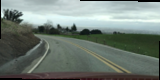

In [ ]:
from PIL import Image as pilimg
img = pilimg.fromarray(train_images[10009], 'RGB')
#img.save('my.png')
img.show()
img

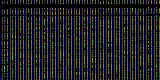

In [ ]:
from keras.models import load_model
from skimage.transform import resize
import numpy as np
import cv2
from keras.preprocessing import image as Image
from PIL import Image as ig
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from keras.models import load_model
from skimage.transform import resize as imresize
image = train_images[10009]
model = load_model('full_CNN_model.h5')
class Lanes():
    def __init__(self):
        self.recent_fit = []
        self.avg_fit = []

    # Get image ready for feeding into model
small_img = imresize(image, (80, 160, 3))
small_img = np.array(small_img)
small_img = small_img[None,:,:,:]

    # Make prediction with neural network (un-normalize value by multiplying by 255)
prediction = model.predict(small_img)[0] * 255
lanes = Lanes()
    # Add lane prediction to list for averaging
lanes.recent_fit.append(prediction)
    # Only using last five for average
if len(lanes.recent_fit) > 5:
    lanes.recent_fit = lanes.recent_fit[1:]

    # Calculate average detection
lanes.avg_fit = np.mean(np.array([i for i in lanes.recent_fit]), axis = 0)

    # Generate fake R & B color dimensions, stack with G
blanks = np.zeros_like(lanes.avg_fit).astype(np.uint8)
lane_drawn = np.dstack((blanks, lanes.avg_fit, blanks))

    # Re-size to match the original image
lane_image = imresize(lane_drawn, (80, 160, 3))

    # Merge the lane drawing onto the original image
result = cv2.addWeighted(image, 1, lane_image, 1, 0,dtype=cv2.CV_64F)


img = pilimg.fromarray(result, 'RGB')
#img.save('my.png')
img.show()
img

In [ ]:
import numpy as np
import cv2
from skimage.transform import resize as imresize
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from keras.models import load_model


# Class to average lanes with
class Lanes():
    def __init__(self):
        self.recent_fit = []
        self.avg_fit = []


def road_lines(image):
    """ Takes in a road image, re-sizes for the model,
    predicts the lane to be drawn from the model in G color,
    recreates an RGB image of a lane and merges with the
    original road image.
    """

    # Get image ready for feeding into model
    small_img = imresize(image, (80, 160, 3))
    small_img = np.array(small_img)
    small_img = small_img[None,:,:,:]

    # Make prediction with neural network (un-normalize value by multiplying by 255)
    prediction = model.predict(small_img)[0] * 255

    # Add lane prediction to list for averaging
    lanes.recent_fit.append(prediction)
    # Only using last five for average
    if len(lanes.recent_fit) > 5:
        lanes.recent_fit = lanes.recent_fit[1:]

    # Calculate average detection
    lanes.avg_fit = np.mean(np.array([i for i in lanes.recent_fit]), axis = 0)

    # Generate fake R & B color dimensions, stack with G
    blanks = np.zeros_like(lanes.avg_fit).astype(np.uint8)
    lane_drawn = np.dstack((blanks, lanes.avg_fit, blanks))

    # Re-size to match the original image
    lane_image = imresize(lane_drawn, (720, 1280, 3))

    # Merge the lane drawing onto the original image
    result = cv2.addWeighted(image, 1, lane_image, 1, 0,dtype=cv2.CV_64F)

    return result


if __name__ == '__main__':
    # Load Keras model
    model = load_model('full_CNN_model.h5')
    # Create lanes object
    lanes = Lanes()

    # Where to save the output video
    vid_output = 'proj_reg_vid.mp4'
    # Location of the input video
    clip1 = VideoFileClip("project_video.mp4")
    # Create the clip
    vid_clip = clip1.fl_image(road_lines)
    vid_clip.write_videofile(vid_output, audio=False)

[MoviePy] >>>> Building video proj_reg_vid.mp4
[MoviePy] Writing video proj_reg_vid.mp4


  7%|▋         | 90/1261 [00:35<08:12,  2.38it/s]

KeyboardInterrupt: ignored